#Intro
In this notebook We will explore and perform EDA on the FD004 file. 

|Dataset	|Operating conditions |	Fault modes|	Train size (nr. of engines)	| Test size (nr. of engines)|
|--------|---|---|-----|-----|
| FD004	| 6	| 2	| 248	| 249 |

In [1]:
#%pip install missingno

In [2]:
import seaborn as sns
import os
import pandas as pd
import numpy as np
np.random.seed(1337)
from IPython.display import Image
import matplotlib as mpl
import matplotlib.pyplot as plt
from pandas import read_csv
from matplotlib import pyplot as plt
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler

import missingno as msno

In [3]:
#%pip install missingno

In [4]:
# settings will be used to avoid exponential values in output or tables and to display 50 rows maximum

pd.set_option('display.float_format', lambda x: '%.3f' % x)
pd.options.display.max_rows=50

In [6]:
# Replace 'file.txt' with the name of your .txt file
train = pd.read_csv('train_FD004.txt', delimiter=' ')

# Print the first few rows of the DataFrame
print(train.head())
print(train.shape)
print(list(train.columns))

   1  1.1  42.0049  0.8400   100.0  445.00  549.68  1343.43  1112.93  3.91  \
0  1    2   20.002   0.700 100.000 491.190 606.070 1477.610 1237.500 9.350   
1  1    3   42.004   0.841 100.000 445.000 548.950 1343.120 1117.050 3.910   
2  1    4   42.000   0.840 100.000 445.000 548.700 1341.240 1118.030 3.910   
3  1    5   25.006   0.621  60.000 462.540 536.100 1255.230 1033.590 7.050   
4  1    6   35.000   0.840 100.000 449.440 554.770 1352.870 1117.010 5.480   

   ...  8074.83  9.3335  0.02  330  2212  100.00  10.62  6.3670  Unnamed: 26  \
0  ... 8046.130   9.191 0.020  361  2324 100.000 24.370  14.655          NaN   
1  ... 8066.620   9.401 0.020  329  2212 100.000 10.480   6.421          NaN   
2  ... 8076.050   9.337 0.020  328  2212 100.000 10.540   6.418          NaN   
3  ... 7865.800  10.837 0.020  305  1915  84.930 14.030   8.675          NaN   
4  ... 8054.100   9.335 0.020  330  2223 100.000 14.910   8.906          NaN   

   Unnamed: 27  
0          NaN  
1          NaN  

In [ ]:
# Rename columns
new_col_names = ['unit', 'time', 'op1', 'op2', 'op3', 'sm1', 'sm2', 'sm3', 'sm4', 'sm5', 'sm6', 'sm7', 'sm8', 'sm9', 'sm10', 'sm11', 'sm12', 'sm13', 'sm14', 'sm15', 'sm16', 'sm17', 'sm18', 'sm19', 'sm20', 'sm21', 'HPC', 'FAN']
train = train.rename(columns={train.columns[i]: new_col_names[i] for i in range(len(train.columns))})

## Check for Missing data

<Axes: >

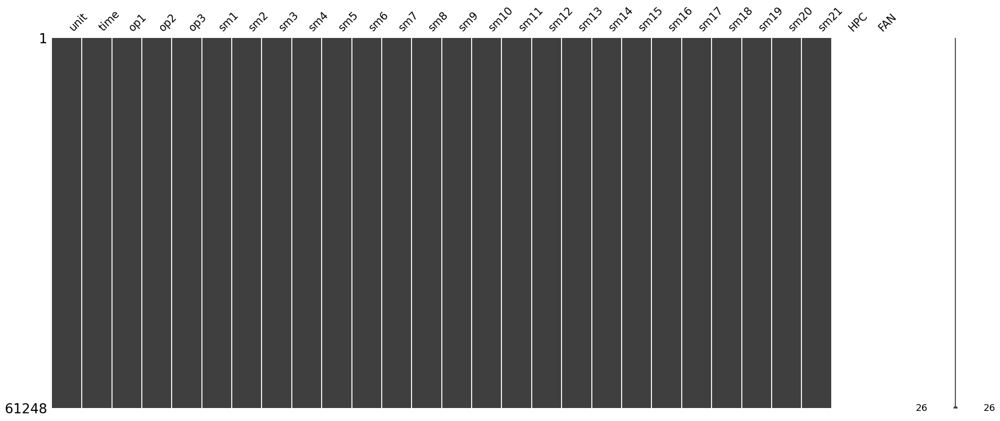

In [8]:
msno.matrix(train)

In [9]:
train.head(5)

,unit,time,op1,op2,op3,sm1,sm2,sm3,sm4,sm5,...,sm14,sm15,sm16,sm17,sm18,sm19,sm20,sm21,HPC,FAN
0,1,2,20.002,0.700,100.000,491.190,606.070,1477.610,1237.500,9.350,...,8046.130,9.191,0.020,361,2324,100.000,24.370,14.655,NaN,NaN
1,1,3,42.004,0.841,100.000,445.000,548.950,1343.120,1117.050,3.910,...,8066.620,9.401,0.020,329,2212,100.000,10.480,6.421,NaN,NaN
2,1,4,42.000,0.840,100.000,445.000,548.700,1341.240,1118.030,3.910,...,8076.050,9.337,0.020,328,2212,100.000,10.540,6.418,NaN,NaN
3,1,5,25.006,0.621,60.000,462.540,536.100,1255.230,1033.590,7.050,...,7865.800,10.837,0.020,305,1915,84.930,14.030,8.675,NaN,NaN
4,1,6,35.000,0.840,100.000,449.440,554.770,1352.870,1117.010,5.480,...,8054.100,9.335,0.020,330,2223,100.000,14.910,8.906,NaN,NaN


In [10]:
train.tail(5)

,unit,time,op1,op2,op3,sm1,sm2,sm3,sm4,sm5,...,sm14,sm15,sm16,sm17,sm18,sm19,sm20,sm21,HPC,FAN
61243,249,251,10.000,0.250,100.000,489.050,605.330,1516.360,1315.280,10.520,...,8185.690,8.454,0.030,372,2319,100.000,29.110,17.523,NaN,NaN
61244,249,252,0.003,0.002,100.000,518.670,643.420,1598.920,1426.770,14.620,...,8185.470,8.222,0.030,396,2388,100.000,39.380,23.715,NaN,NaN
61245,249,253,0.003,0.000,100.000,518.670,643.680,1607.720,1430.560,14.620,...,8193.940,8.252,0.030,395,2388,100.000,39.780,23.827,NaN,NaN
61246,249,254,35.005,0.840,100.000,449.440,555.770,1381.290,1148.180,5.480,...,8125.640,9.052,0.020,337,2223,100.000,15.260,9.077,NaN,NaN
61247,249,255,42.003,0.840,100.000,445.000,549.850,1369.750,1147.450,3.910,...,8144.330,9.121,0.020,333,2212,100.000,10.660,6.434,NaN,NaN


In [11]:
train.describe()

,unit,time,op1,op2,op3,sm1,sm2,sm3,sm4,sm5,...,sm14,sm15,sm16,sm17,sm18,sm19,sm20,sm21,HPC,FAN
count,61248.000,61248.000,61248.000,61248.000,61248.000,61248.000,61248.000,61248.000,61248.000,61248.000,...,61248.000,61248.000,61248.000,61248.000,61248.000,61248.000,61248.000,61248.000,0.000,0.000
mean,124.327,134.314,24.000,0.571,94.031,472.883,579.421,1417.898,1201.917,8.032,...,8067.812,9.286,0.023,347.760,2228.614,97.751,20.865,12.519,NaN,NaN
std,71.994,89.783,14.781,0.311,14.252,26.437,37.343,106.168,119.328,3.623,...,85.671,0.750,0.005,27.808,145.474,5.369,9.936,5.963,NaN,NaN
min,1.000,1.000,0.000,0.000,60.000,445.000,535.480,1242.670,1024.420,3.910,...,7845.780,8.176,0.020,302.000,1915.000,84.930,10.160,6.084,NaN,NaN
25%,60.000,62.000,10.005,0.251,100.000,445.000,549.330,1350.550,1119.490,3.910,...,8062.630,8.648,0.020,330.000,2212.000,100.000,10.947,6.566,NaN,NaN
50%,126.000,123.000,25.001,0.700,100.000,462.540,555.740,1367.680,1136.920,7.050,...,8083.815,9.256,0.020,334.000,2223.000,100.000,14.930,8.960,NaN,NaN
75%,185.000,191.000,41.998,0.840,100.000,491.190,607.070,1497.420,1302.620,10.520,...,8128.350,9.366,0.030,368.000,2324.000,100.000,28.560,17.136,NaN,NaN
max,249.000,543.000,42.008,0.842,100.000,518.670,644.420,1613.000,1440.770,14.620,...,8261.650,11.066,0.030,399.000,2388.000,100.000,39.890,23.885,NaN,NaN


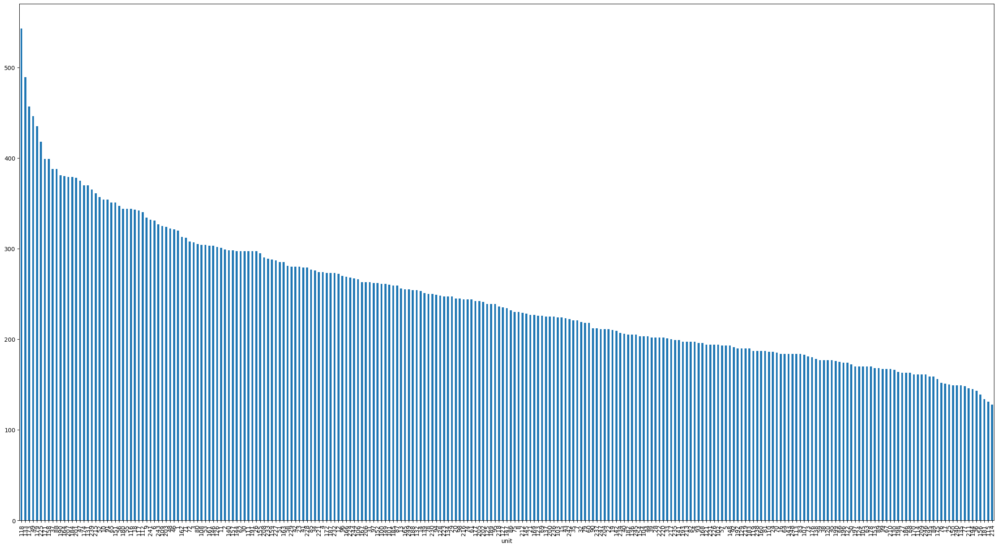

In [12]:
plt.figure(figsize=(30,16))
train.unit.value_counts().plot.bar()
plt.xticks(rotation=90)
plt.rcParams.update({'font.size': 8})

### Lets look at the sensor data for unit 1

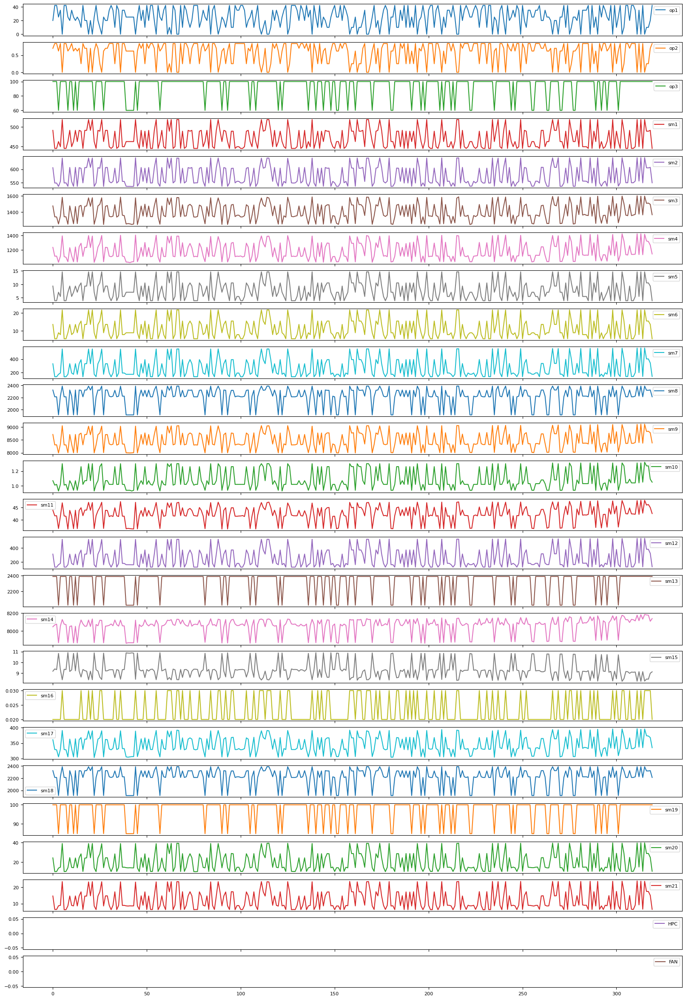

In [13]:
### plotting sensor data for engine ID  - Unit 1
engine_unit = train[train['unit'] == 1]

ax1 = engine_unit[train.columns[2:]].plot(subplots=True, figsize=(20,30))

In [14]:

### CALCULATE RUL TRAIN ###
train['RUL']=train.groupby(['unit'])['time'].transform(max)-train['time']
train.RUL[0:10]

0    319
1    318
2    317
3    316
4    315
5    314
6    313
7    312
8    311
9    310
Name: RUL, dtype: int64

In [15]:
### ADD NEW LABEL TRAIN ###
w1 = 45
w0 = 15
train['label1'] = np.where(train['RUL'] <= w1, 1, 0 )
train['label2'] = train['label1']
train.loc[train['RUL'] <= w0, 'label2'] = 2

In [16]:
train_OG = train.copy()

### SCALE TRAIN DATA ###

def scale(df):
    return (df - df.mean())/df.std()
    return (df - df.min())/(df.max()-df.min())

for col in train.columns:
    if col[0] == 's':
        train[col] = scale(train[col])
    elif col == 'time':
        train['cycle_norm'] = scale(train[col])
        
train = train.dropna(axis=1)
train.head()

,unit,time,op1,op2,op3,sm1,sm2,sm3,sm4,sm5,...,sm16,sm17,sm18,sm19,sm20,sm21,RUL,label1,label2,cycle_norm
0,1,2,20.002,0.700,100.000,0.692,0.714,0.562,0.298,0.364,...,-0.694,0.476,0.656,0.419,0.353,0.358,319,0,0,-1.474
1,1,3,42.004,0.841,100.000,-1.055,-0.816,-0.704,-0.711,-1.138,...,-0.694,-0.675,-0.114,0.419,-1.045,-1.023,318,0,0,-1.463
2,1,4,42.000,0.840,100.000,-1.055,-0.823,-0.722,-0.703,-1.138,...,-0.694,-0.711,-0.114,0.419,-1.039,-1.023,317,0,0,-1.451
3,1,5,25.006,0.621,60.000,-0.391,-1.160,-1.532,-1.411,-0.271,...,-0.694,-1.538,-2.156,-2.388,-0.688,-0.645,316,0,0,-1.440
4,1,6,35.000,0.840,100.000,-0.887,-0.660,-0.612,-0.712,-0.704,...,-0.694,-0.639,-0.039,0.419,-0.599,-0.606,315,0,0,-1.429


### It looks like there a few variables with stagnant readings, lets remove these and continue the EDA

In [17]:
train.drop(['sm1', 'sm5', 'sm10', 'sm16', 
            'op3'], axis=1, inplace=True)

In [18]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61248 entries, 0 to 61247
Data columns (total 25 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   unit        61248 non-null  int64  
 1   time        61248 non-null  int64  
 2   op1         61248 non-null  float64
 3   op2         61248 non-null  float64
 4   sm2         61248 non-null  float64
 5   sm3         61248 non-null  float64
 6   sm4         61248 non-null  float64
 7   sm6         61248 non-null  float64
 8   sm7         61248 non-null  float64
 9   sm8         61248 non-null  float64
 10  sm9         61248 non-null  float64
 11  sm11        61248 non-null  float64
 12  sm12        61248 non-null  float64
 13  sm13        61248 non-null  float64
 14  sm14        61248 non-null  float64
 15  sm15        61248 non-null  float64
 16  sm17        61248 non-null  float64
 17  sm18        61248 non-null  float64
 18  sm19        61248 non-null  float64
 19  sm20        61248 non-nul

In [19]:
train.tail()

,unit,time,op1,op2,sm2,sm3,sm4,sm6,sm7,sm8,...,sm15,sm17,sm18,sm19,sm20,sm21,RUL,label1,label2,cycle_norm
61243,249,251,10.000,0.250,0.694,0.927,0.950,0.711,0.826,0.626,...,-1.108,0.872,0.621,0.419,0.830,0.839,4,1,2,1.300
61244,249,252,0.003,0.002,1.714,1.705,1.884,1.833,1.935,1.099,...,-1.417,1.735,1.096,0.419,1.863,1.878,3,1,2,1.311
61245,249,253,0.003,0.000,1.721,1.788,1.916,1.833,1.945,1.100,...,-1.377,1.699,1.096,0.419,1.904,1.896,2,1,2,1.322
61246,249,254,35.005,0.840,-0.633,-0.345,-0.450,-0.667,-0.568,-0.034,...,-0.312,-0.387,-0.039,0.419,-0.564,-0.577,1,1,2,1.333
61247,249,255,42.003,0.840,-0.792,-0.454,-0.456,-1.084,-0.959,-0.111,...,-0.220,-0.531,-0.114,0.419,-1.027,-1.021,0,1,2,1.344


In [20]:
train.columns

Index(['unit', 'time', 'op1', 'op2', 'sm2', 'sm3', 'sm4', 'sm6', 'sm7', 'sm8',
       'sm9', 'sm11', 'sm12', 'sm13', 'sm14', 'sm15', 'sm17', 'sm18', 'sm19',
       'sm20', 'sm21', 'RUL', 'label1', 'label2', 'cycle_norm'],
      dtype='object')

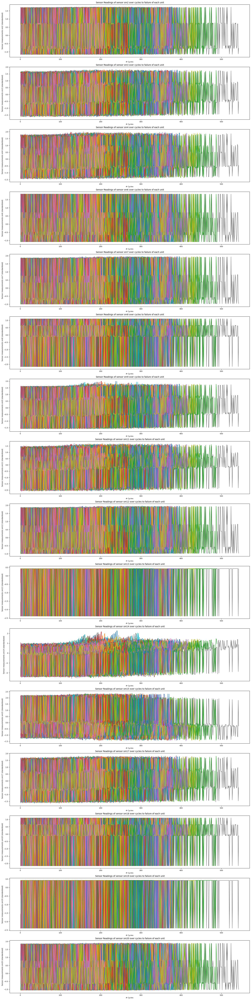

In [21]:

fig, axes = plt.subplots(nrows=16, ncols=1, figsize=(16,64), constrained_layout = True)

cols = train.columns
cols2 = cols[4:20].copy()

for j,ax in enumerate(axes):
    axes[j].set_xlabel('# Cycles')
    axes[j].set_ylabel(f'Sensor measurements {cols2[j]} (standardized)')
    axes[j].set_title(f' Sensor Readings of sensor {cols2[j]} over cycles to failure of each unit')
    for i in range(1,259+1):
        ax.plot(train[train.unit==i].time.to_numpy(), train[train.unit==i][cols2[j]].to_numpy())
    # end
# end


## These Beautiful 'Monet' Graphs are quite telling as you can almost see where in general the sensors begin to go haywire after about 125 days

In [22]:
print(train.shape)

(61248, 25)


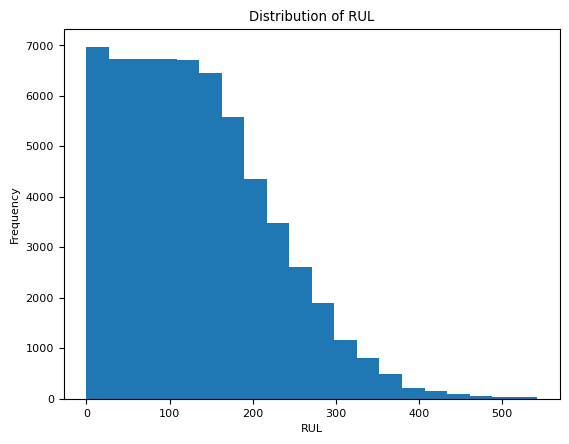

In [23]:
plt.hist(train['RUL'], bins=20)
plt.xlabel('RUL')
plt.ylabel('Frequency')
plt.title('Distribution of RUL')
plt.show()

## Lets look at the data with the standardized variables

C:\Users\Mike Dubois\AppData\Local\Temp\ipykernel_12152\3902760035.py:13: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


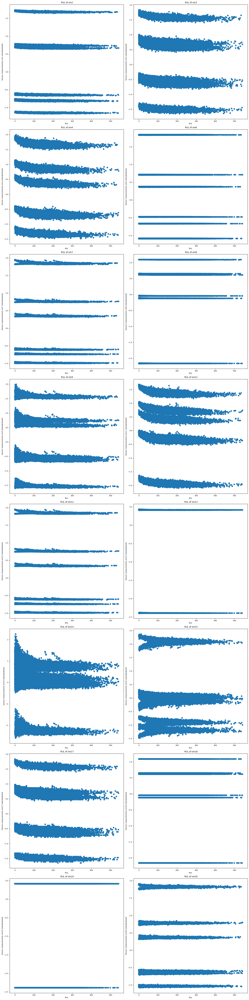

In [24]:
fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(16,64), constrained_layout = True)

cols = train.columns
cols2 = cols[4:20].copy()

for i in range(8):
    for j in range(2):
        ax = axes[i, j]
        ax.set_xlabel('RUL')
        ax.set_ylabel(f'Sensor measurements {cols2[i*2+j]} (standardized)')
        ax.set_title(f' RUL of {cols2[i*2+j]}')
        ax.scatter(train['RUL'],train[cols2[i*2+j]])
        plt.tight_layout()

# Scatterplots without the standardized Data

C:\Users\Mike Dubois\AppData\Local\Temp\ipykernel_12152\3293856906.py:13: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


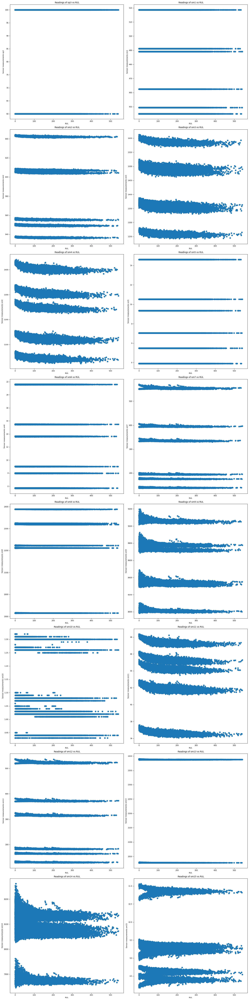

In [25]:
fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(16,64), constrained_layout = True)

cols = train_OG.columns
cols2 = cols[4:20].copy()

for i in range(8):
    for j in range(2):
        ax = axes[i, j]
        ax.set_xlabel('RUL')
        ax.set_ylabel(f'Sensor measurements {cols2[i*2+j]}')
        ax.set_title(f' Readings of {cols2[i*2+j]} vs RUL')
        ax.scatter(train_OG['RUL'],train_OG[cols2[i*2+j]])
        plt.tight_layout()

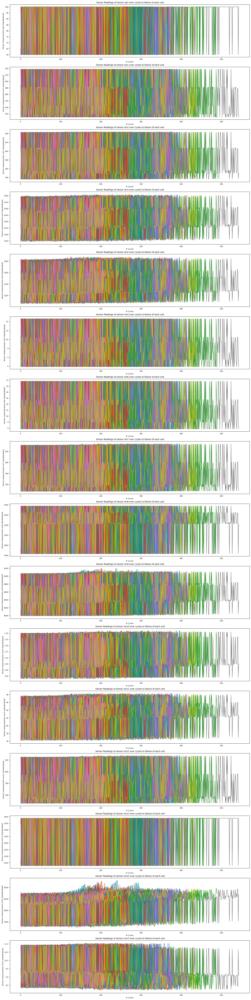

In [26]:
fig, axes = plt.subplots(nrows=16, ncols=1, figsize=(16,64), constrained_layout = True)

cols = train_OG.columns
cols2 = cols[4:20].copy()

for j,ax in enumerate(axes):
    axes[j].set_xlabel('# Cycles')
    axes[j].set_ylabel(f'Sensor measurements {cols2[j]} (standardized)')
    axes[j].set_title(f' Sensor Readings of sensor {cols2[j]} over cycles to failure of each unit')
    for i in range(1,259+1):
        ax.plot(train_OG[train_OG.unit==i].time.to_numpy(), train_OG[train_OG.unit==i][cols2[j]].to_numpy())
    # end
# end
